In [1]:
import os
import random
from tqdm.notebook import tqdm
import matplotlib
import matplotlib.pyplot as plt
import open3d as o3d

import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns

%env CUDA_VISIBLE_DEVICES=3
import torch
torch.no_grad()
print("cuda available: " + str(torch.cuda.is_available()))

import cuml
from torchvision.utils import save_image, make_grid

from draw import draw

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.
env: CUDA_VISIBLE_DEVICES=3
cuda available: True


In [2]:
from matplotlib import rcParams, rcParamsDefault
rcParams.update(rcParamsDefault)
plt.rcParams.update({'font.size': 15})

## Set directories
1. summary file path: summary_name
2. path to save images: save_dir

In [3]:
save_dir = 'images'
experiment_name = 'syn_sadefeldman_beta1_noised_std0.73_zscales_8_16_32'
summary_name = os.path.join('/localdata/rna_rep_learning/scset/checkpoints/', experiment_name, 'summary.pth')

imgdir = os.path.join(save_dir, experiment_name)
imgdir_gt = os.path.join(imgdir, 'gt')
imgdir_recon = os.path.join(imgdir, 'recon')
imgdir_gen = os.path.join(imgdir, 'gen')

os.makedirs(save_dir, exist_ok=True)
os.makedirs(imgdir_gt, exist_ok=True)
os.makedirs(imgdir_recon, exist_ok=True)
os.makedirs(imgdir_gen, exist_ok=True)

In [4]:
summary_name

'/localdata/rna_rep_learning/scset/checkpoints/syn_sadefeldman_beta1_noised_std0.73_zscales_8_16_32/summary.pth'

In [5]:
summary = torch.load(summary_name)
for k, v in summary.items():
    try:
        print(f"{k}: {v.shape}")
    except AttributeError:
        print(f"{k}: {len(v)}")

smp_set: torch.Size([120, 700, 20])
smp_mask: torch.Size([120, 700])
smp_att: 3
priors: 4
recon_set: torch.Size([120, 700, 20])
recon_mask: torch.Size([120, 700])
posteriors: 4
dec_att: 3
enc_att: 3
enc_hiddens: 15
init_set: torch.Size([120, 700, 64])
dec_hiddens: 15
dec_latents: 15
gt_set: torch.Size([120, 403, 20])
gt_mask: torch.Size([120, 403])
mean: torch.Size([15])
std: torch.Size([15])
sid: 15
mid: 15
pid: 15
cardinality: 15


## Select the samples to visualize
- parse the samples by index.
- below default code will visualize all samples. **Warning: Requires Huge Memory**

In [6]:
recon_targets = list(range(len(summary['gt_mask'])))[:]
gen_targets = list(range(len(summary['smp_mask'])))[:]

len_att = len(summary['dec_att'])
gt = summary['gt_set'][recon_targets]
gt_mask = summary['gt_mask'][recon_targets]

recon = summary['recon_set'][recon_targets]
recon_mask = summary['recon_mask'][recon_targets]

dec_att = [summary['dec_att'][l][:, :, recon_targets] for l in range(len_att)]
enc_att = [summary['enc_att'][l][:, :, recon_targets] for l in range(len_att)]

gen = summary['smp_set'][gen_targets]
gen_mask = summary['smp_mask'][gen_targets]
gen_att = [summary['smp_att'][l][:, :, gen_targets] for l in range(len_att)]

## Visualize

In [6]:
def visualize(gt, gt_mask):
    return draw(gt, gt_mask)

### Visualize Recon

In [7]:
recon_imgs = visualize(recon, recon_mask)
for idx in range(len(recon_targets)):
    data_idx = recon_targets[idx]
    if torch.nonzero(recon_imgs[idx].float().mean(0) != 1).shape[0] == 0:
        print("SKIP")
        continue
    save_image(recon_imgs[idx] / 255., os.path.join(imgdir_recon, f'{data_idx}.png'))
del recon_imgs

### Visualize GT

In [8]:
gt_imgs = visualize(gt, gt_mask)
for idx in range(len(recon_targets)):
    data_idx = recon_targets[idx]
    if torch.nonzero(gt_imgs[idx].float().mean(0) != 1).shape[0] == 0:
        print("SKIP")
        continue
    save_image(gt_imgs[idx]/255, os.path.join(imgdir_gt, f'{data_idx}.png'))
del gt_imgs

### Visualize Generated Samples

In [9]:
gen_imgs = visualize(gen, gen_mask)
for idx in range(len(gen_targets)):
    if torch.nonzero(gen_imgs[idx].float().mean(0) != 1).shape[0] == 0:
        print("SKIP")
        continue
    data_idx = gen_targets[idx]
    save_image(gen_imgs[idx]/255, os.path.join(imgdir_gen, f'{data_idx}.png'))
del gen_imgs

In [10]:
print("Done")

Done


# Collate data across all samples. run UMAP, and viz

inputs were of size 350 cells each; it reconstructed (and generated) samples of 700 cells each
I thought that reconstruction should be set to have the same cardinality as gt?

In [7]:
print(gt.shape)
print(recon.shape)

torch.Size([120, 403, 20])
torch.Size([120, 700, 20])


In [7]:
gt_adata = sc.read_h5ad("/localdata/rna_rep_learning/sadefeldman/synthetic_data/syn_adata_noised_std_0.7261.h5ad")


In [9]:
recon_adata = sc.AnnData(np.zeros([recon.reshape(-1,20)[(~recon_mask).reshape(-1),:].shape[0], len(gt_adata.var)])) #only take unmasked outputs!!!

/tmp/ipykernel_785324/1952249712.py:1: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  recon_adata = sc.AnnData(np.zeros([recon.reshape(-1,20)[(~recon_mask).reshape(-1),:].shape[0], len(gt_adata.var)])) #only take unmasked outputs!!!


In [10]:
recon_adata.varm['PCs'] = gt_adata.varm['PCs']

In [11]:
recon_adata.obsm['X_pca'] = recon.reshape(-1,20)[(~recon_mask).reshape(-1),:].numpy() #only take unmasked outputs!!

In [12]:
gt_adata.var.columns = [s.replace("_orig_orig_orig_orig_orig","_orig") for s in gt_adata.var.columns]

In [13]:
recon_adata.var = gt_adata.var[['n_cells_orig','highly_variable_orig','means_orig','mean_orig','std_orig']]

#### calculate neighbors & UMAP for reconstructed cells

In [15]:
sc.pp.neighbors(recon_adata, n_neighbors=30, n_pcs=20)

In [16]:
sc.tl.umap(recon_adata)

In [17]:
recon_adata.obs['pid'] = np.repeat(np.array(summary['pid']).reshape(-1), (~recon_mask).sum(axis=1))

In [18]:
#got an error with cmap so manually assigning colors to pids
recon_adata.uns['pid_colors'] = [matplotlib.colors.to_hex(matplotlib.cm.get_cmap('tab20')(i)) for i in np.linspace(0.0, 1.0, len(np.array(summary['pid']).reshape(-1)))]

/opt/conda/rpeyser/envs/scset/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


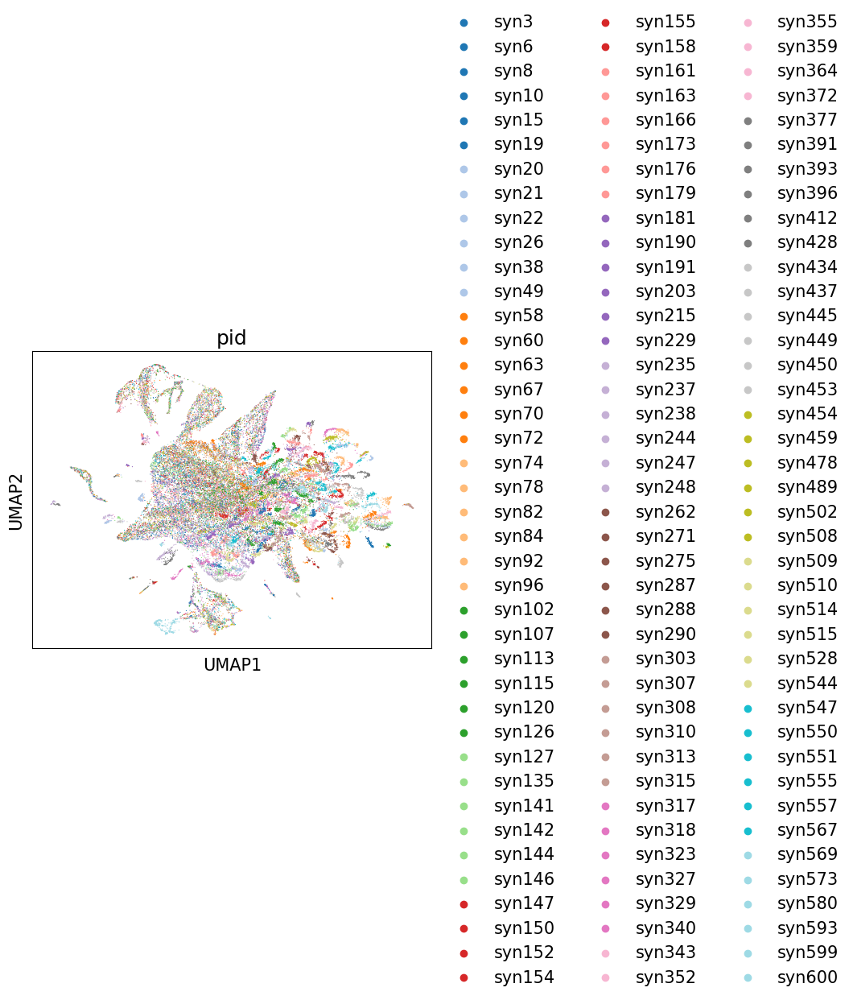

In [19]:
sc.pl.umap(recon_adata, color='pid')

In [19]:
#add PCs to obs in order to color by them
recon_adata.obs = pd.concat([recon_adata.obs, pd.DataFrame(recon_adata.obsm['X_pca'], index=recon_adata.obs.index, columns=["PC"+str(i) for i in range(1,recon_adata.obsm['X_pca'].shape[1]+1)])], axis=1)

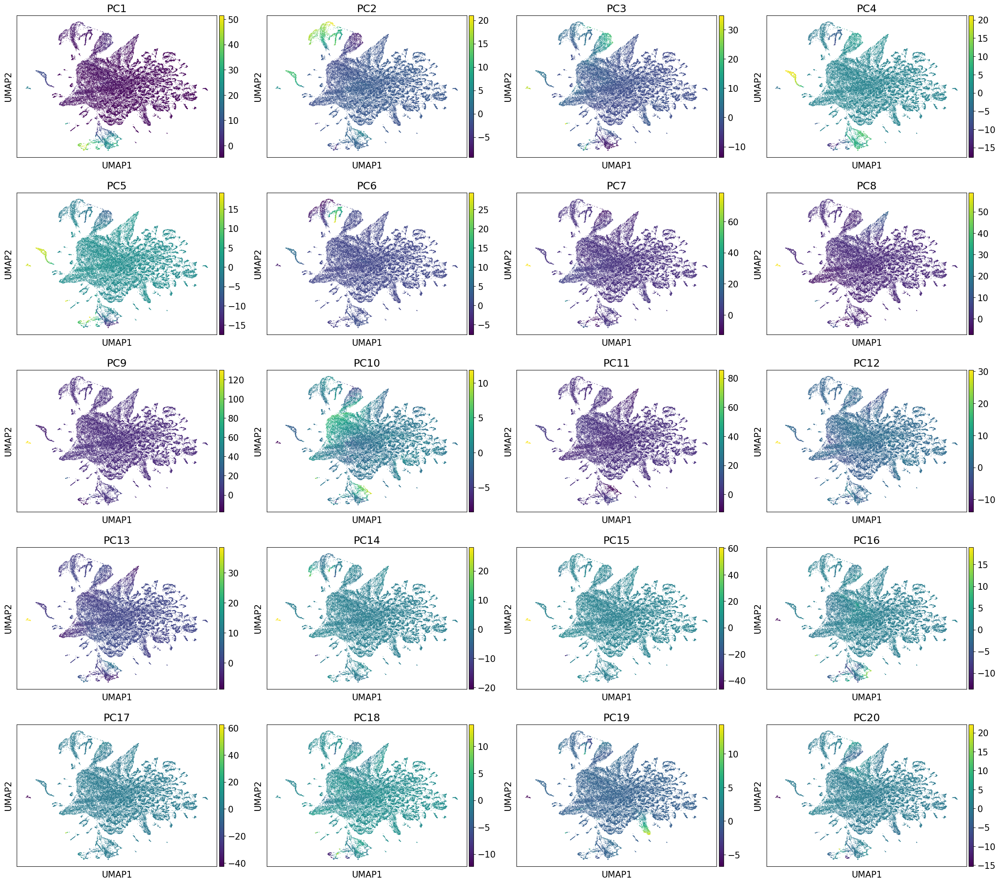

In [21]:
sc.pl.umap(recon_adata, color=["PC"+str(i) for i in range(1,21)])

#### UMAP on ground truth synthetic data

In [19]:
#run UMAP on the original synthetic gt_adata (in future this might already be saved)
umap = cuml.UMAP(n_epochs=10000, min_dist = 0, local_connectivity=16)
umap_trans = umap.fit_transform(gt_adata.obsm['X_pca'][:,:20])
gt_adata.obsm['X_umap'] = umap_trans

In [20]:
#add PCs to gt obs in order to color by them
gt_adata.obs[["PC"+str(i) for i in range(1,gt_adata.obsm['X_pca'].shape[1]+1)]] = gt_adata.obsm['X_pca']


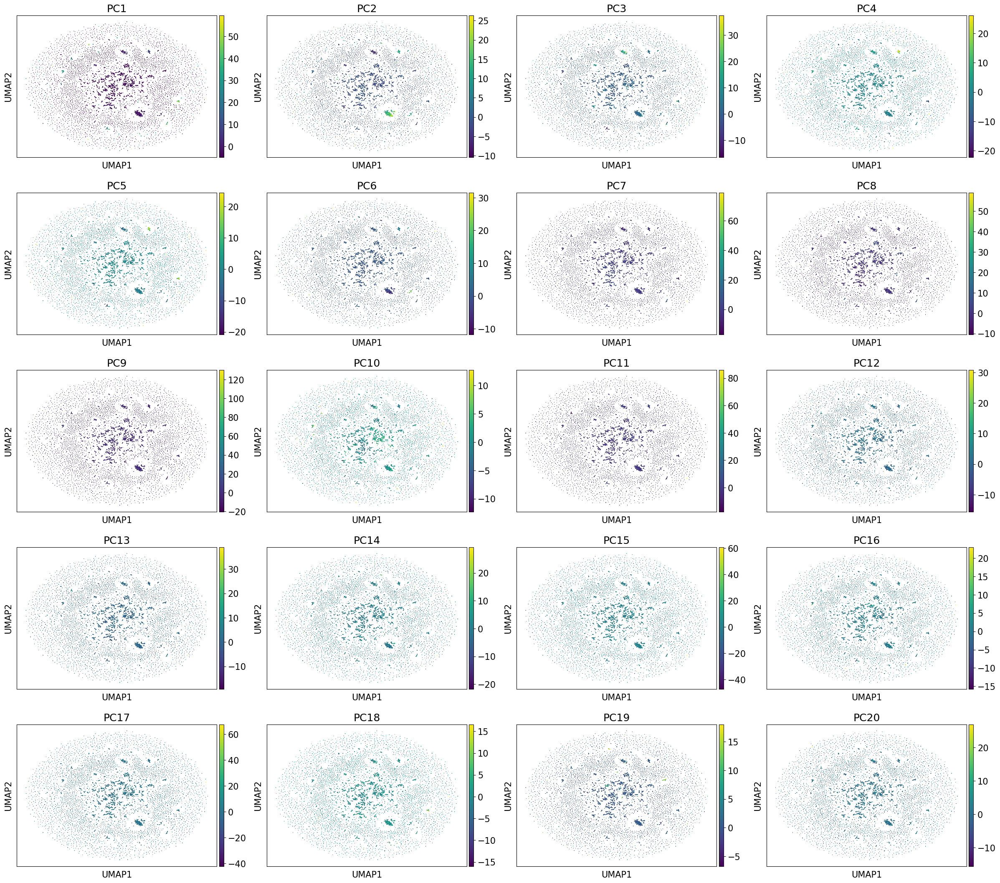

In [21]:
sc.pl.umap(gt_adata, color=["PC"+str(i) for i in range(1,21)])

#### calculate gene expression based on predicted PCs for reconstructed data (as a baseline, check how different PC-reconstructed gene expression and true gene expression is for gt data)

In [20]:
recon_adata.X = np.matmul(recon_adata.obsm['X_pca'], recon_adata.varm['PCs'][:,:20].transpose())

In [21]:
# why does CD4 end up with 0 expression in the plots below?
recon_adata.varm['PCs'][recon_adata.var.index=="CD8A",:20]

array([[-0.00688789,  0.02603726, -0.03506   ,  0.00394523,  0.00140246,
        -0.03171212,  0.01886812, -0.00831117,  0.05149677, -0.05016657,
         0.00774657, -0.03459834,  0.00470292, -0.01731918,  0.03411097,
        -0.0165008 ,  0.0240727 , -0.01728475, -0.00912871,  0.00898244]],
      dtype=float32)

In [22]:
# why does CD4 end up with 0 expression in the plots below?
recon_adata.varm['PCs'][recon_adata.var.index=="CD4",:20]

array([[ 1.7425802e-02, -1.0756901e-02, -9.0012038e-03, -2.4326168e-02,
         8.1602175e-04,  1.7788956e-02, -8.3762258e-03,  2.5697554e-02,
        -5.2553046e-02,  7.6285988e-02, -4.0111534e-02,  1.6070690e-05,
         2.6039046e-03,  1.5964380e-02, -2.1835743e-02,  1.3160137e-02,
         1.7335784e-03,  2.3786383e-02, -1.3584068e-02, -7.5752479e-03]],
      dtype=float32)

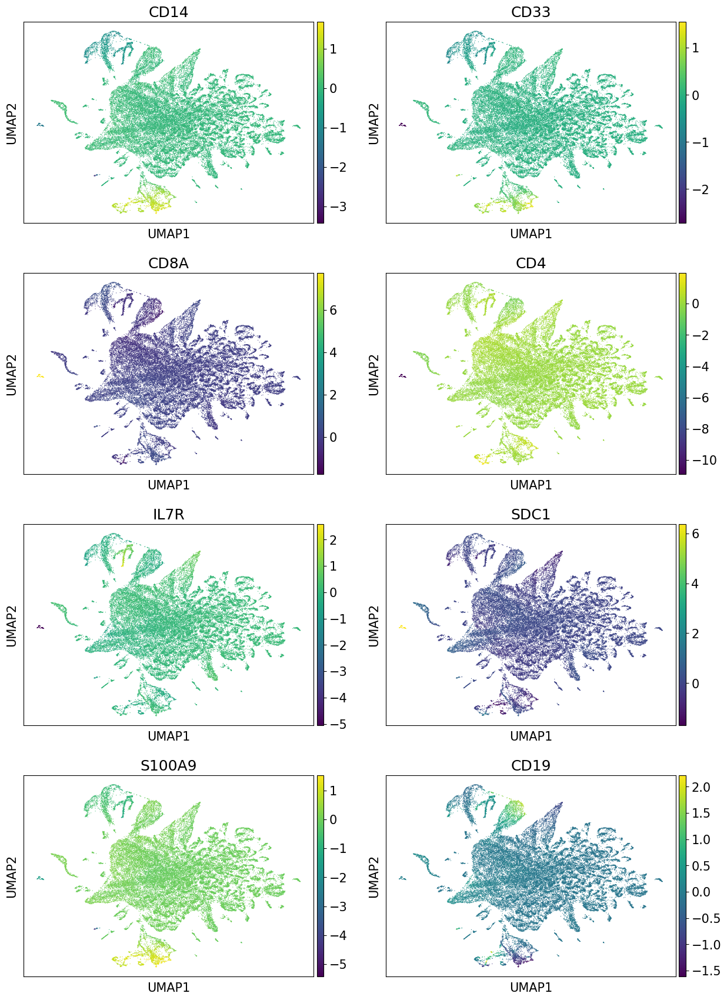

In [23]:
sc.pl.umap(recon_adata, color=['CD14','CD33','CD8A','CD4','IL7R','SDC1','S100A9','CD19'], ncols=2)

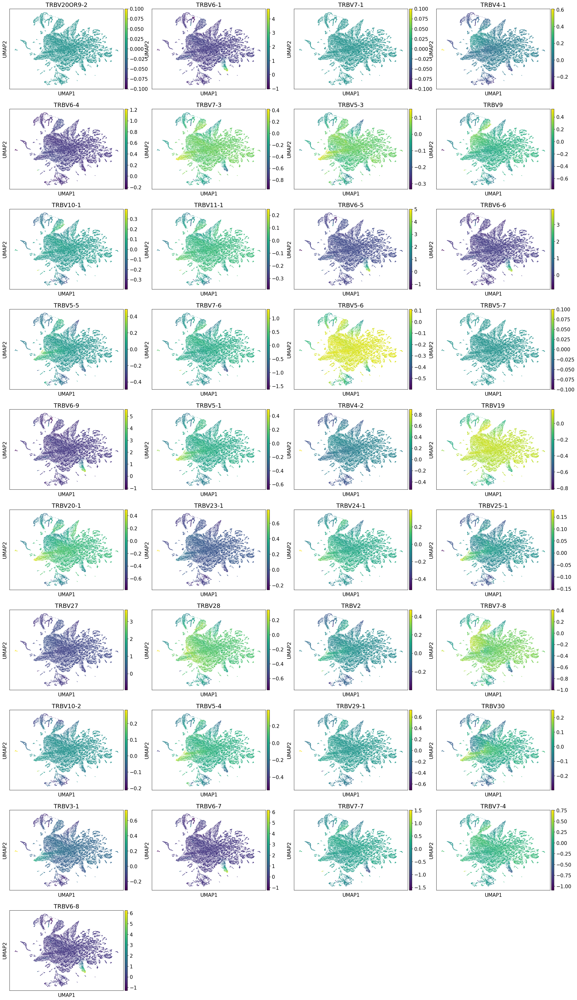

In [109]:
sc.pl.umap(recon_adata, color=recon_adata.var.index[recon_adata.var.index.str.match("TRBV")])

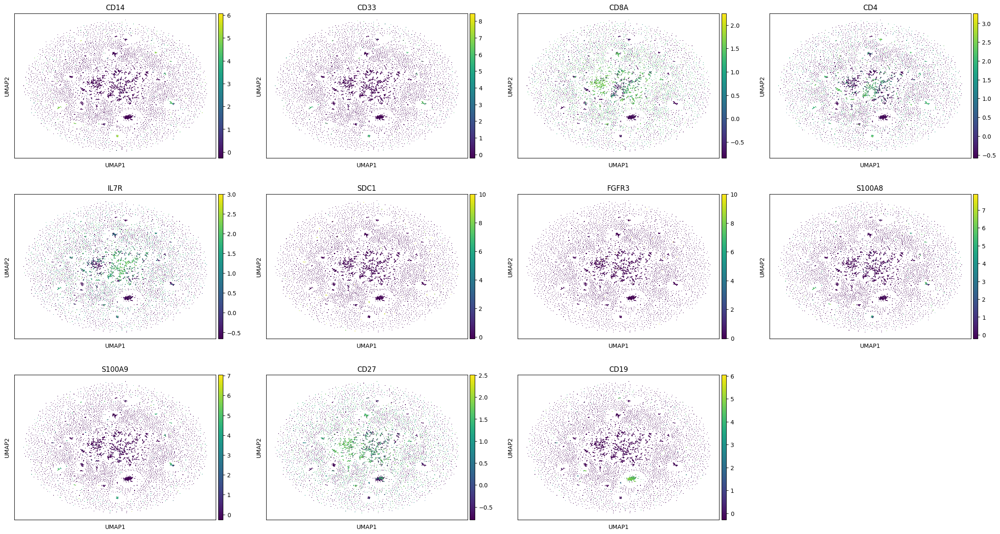

In [45]:
sc.pl.umap(gt_adata, color=['CD14','CD33','CD8A','CD4','IL7R','SDC1','FGFR3','S100A8','S100A9','CD27','CD19'], )

# do reconstructed training images have same issue 

In [ ]:
experiment_name = 'syn_sadefeldman_beta1_noised_std0.73_zscales_8_16_32'
summary_train_name = os.path.join('/localdata/rna_rep_learning/scset/checkpoints/', experiment_name, 'summary_train_recon.pth')

summary_train = torch.load(summary_train_name)
for k, v in summary_train.items():
    try:
        print(f"{k}: {v.shape}")
    except AttributeError:
        print(f"{k}: {len(v)}")

recon_set: torch.Size([480, 700, 20])
recon_mask: torch.Size([480, 700])
posteriors: 4
dec_att: 3
enc_att: 3
enc_hiddens: 60
gt_set: torch.Size([480, 403, 20])
gt_mask: torch.Size([480, 403])
mean: torch.Size([60])
std: torch.Size([60])
sid: 60
mid: 60
pid: 60
cardinality: 60


In [ ]:
len_att = len(summary_train['dec_att'])
gt_train = summary_train['gt_set']
gt_mask_train = summary_train['gt_mask']

recon_train = summary_train['recon_set']
recon_mask_train = summary_train['recon_mask']

dec_att_train = [summary_train['dec_att'][l] for l in range(len_att)]
enc_att_train = [summary_train['enc_att'][l] for l in range(len_att)]

In [ ]:
recon_train_adata = sc.AnnData(np.zeros([recon_train.reshape(-1,20).shape[0], len(gt_adata.var)], dtype=np.float32))

In [ ]:
recon_train_adata.varm['PCs'] = gt_adata.varm['PCs']

In [ ]:
recon_train_adata.obsm['X_pca'] = recon_train.reshape(-1,20).numpy()

In [ ]:
recon_train_adata.var = gt_adata.var[['n_cells_orig','highly_variable_orig','means_orig','mean_orig','std_orig']]

In [ ]:
recon_train_adata

AnnData object with n_obs × n_vars = 336000 × 18136
    var: 'n_cells_orig', 'highly_variable_orig', 'means_orig', 'mean_orig', 'std_orig'
    obsm: 'X_pca'
    varm: 'PCs'

#### calculate neighbors & UMAP for reconstructed cells (train set)

In [ ]:
#neighbors; sc.tl.umap(recon_adata) #going to take too long, use cuml
umap = cuml.UMAP(min_dist = 0.1, n_epochs=1000)#, local_connectivity=16) #n_epochs=1000, 
umap_trans = umap.fit_transform(recon_train_adata.obsm['X_pca'][:,:20])
recon_train_adata.obsm['X_umap'] = umap_trans

(array([1.00000e+00, 2.00000e+00, 0.00000e+00, 0.00000e+00, 1.00000e+00,
        5.00000e+00, 6.71989e+05, 1.00000e+00, 0.00000e+00, 1.00000e+00]),
 array([-205144.71875   , -171967.28125   , -138789.84375   ,
        -105612.4140625 ,  -72434.984375  ,  -39257.546875  ,
          -6080.11230469,   27097.32226562,   60274.7578125 ,
          93452.1875    ,  126629.625     ]),
 <BarContainer object of 10 artists>)

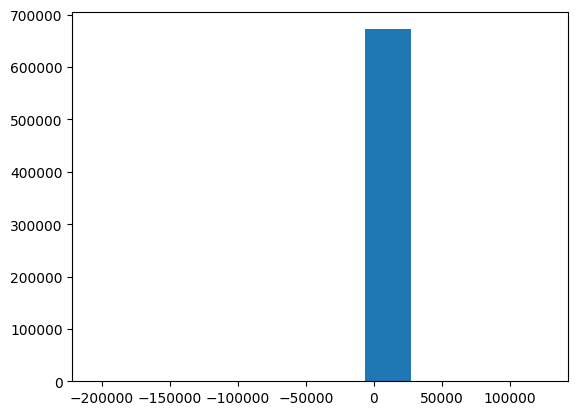

In [ ]:
plt.hist(recon_train_adata.obsm['X_umap'].reshape(-1))

Text(0, 0.5, 'principal component 2')

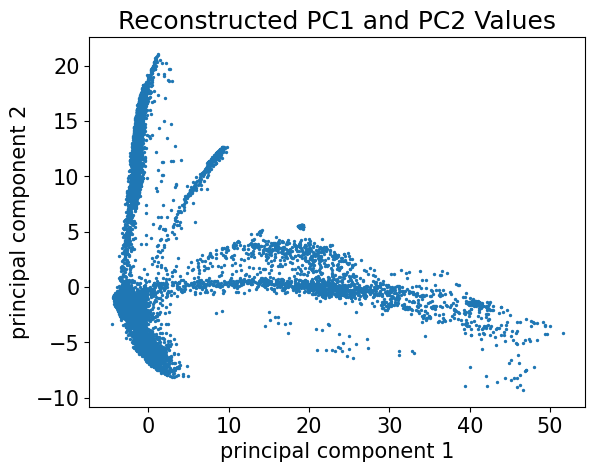

In [ ]:
plt.scatter(recon_adata.obsm['X_pca'] [:,0], recon_adata.obsm['X_pca'][:,1], s=2)
plt.title("Reconstructed PC1 and PC2 Values")
plt.xlabel("principal component 1")
plt.ylabel("principal component 2")

Text(0, 0.5, 'principal component 2')

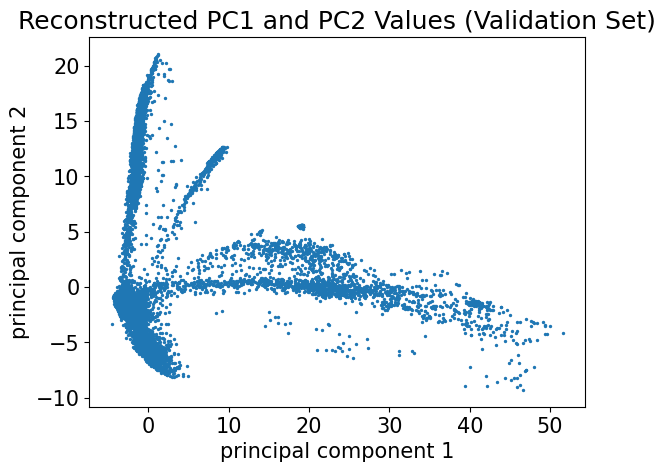

In [112]:
plt.scatter(recon_adata.obsm['X_pca'] [:,0], recon_adata.obsm['X_pca'][:,1], s=2)
plt.title("Reconstructed PC1 and PC2 Values (Validation Set)")
plt.xlabel("principal component 1")
plt.ylabel("principal component 2")

Text(0, 0.5, 'principal component 2')

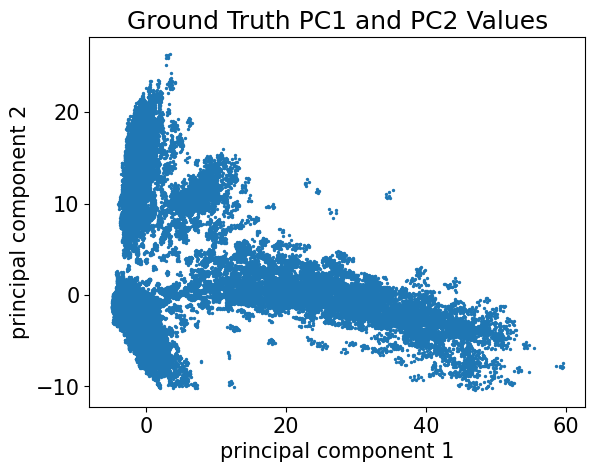

In [113]:
plt.scatter(gt_adata.obsm['X_pca'] [:,0], gt_adata.obsm['X_pca'][:,1], s=2)
plt.title("Ground Truth PC1 and PC2 Values")
plt.xlabel("principal component 1")
plt.ylabel("principal component 2")


In [ ]:
recon_train_adata.obs['pid'] = np.repeat(np.array(summary_train['pid']).reshape(-1), recon_train.shape[1])

In [ ]:
#got an error with cmap so manually assigning colors to pids
recon_train_adata.uns['pid_colors'] = [matplotlib.colors.to_hex(matplotlib.cm.get_cmap('tab20')(i)) for i in np.linspace(0.0, 1.0, len(np.array(summary_train['pid']).reshape(-1)))]

/opt/conda/rpeyser/envs/scset/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  cax = scatter(


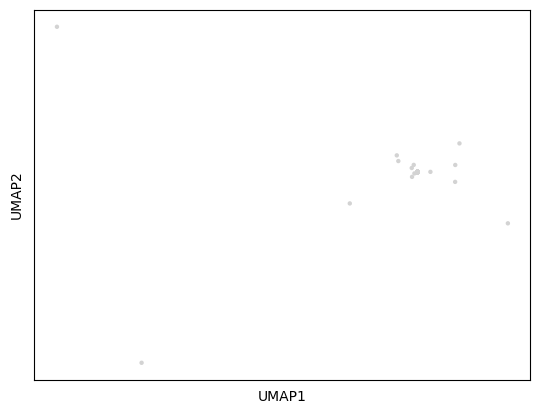

In [ ]:
sc.pl.umap(recon_train_adata, s=40)#, color="pid")

# Viz Patient Reps

### val set

In [11]:
summary = torch.load(summary_name)
for k, v in summary.items():
    try:
        print(f"{k}: {v.shape}")
    except AttributeError:
        print(f"{k}: {len(v)}")
        
#there are 15 batches
#each batch is size 8

# summary['enc_hiddens'] is list of size 15 (n batches). Each list contains a tensor of size 5 (number of VAE layers). Each tensor is [8, M, 64] = [batch, init_dim (M inducing points, ranging from 32 to 2), hidden_dim]

smp_set: torch.Size([120, 700, 20])
smp_mask: torch.Size([120, 700])
smp_att: 3
priors: 4
recon_set: torch.Size([120, 700, 20])
recon_mask: torch.Size([120, 700])
posteriors: 4
dec_att: 3
enc_att: 3
enc_hiddens: 15
init_set: torch.Size([120, 700, 64])
dec_hiddens: 15
dec_latents: 15
gt_set: torch.Size([120, 403, 20])
gt_mask: torch.Size([120, 403])
mean: torch.Size([15])
std: torch.Size([15])
sid: 15
mid: 15
pid: 15
cardinality: 15


In [50]:
summary['gt_mask'].shape

torch.Size([120, 403])

In [12]:
len(summary['pid'][0])

8

In [13]:
len(summary['enc_hiddens'])

15

In [14]:
len(summary['enc_hiddens'][1])

3

### repeat for all levels of encoder

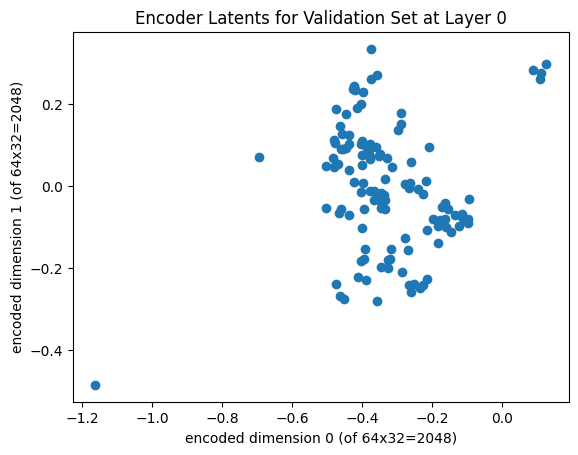

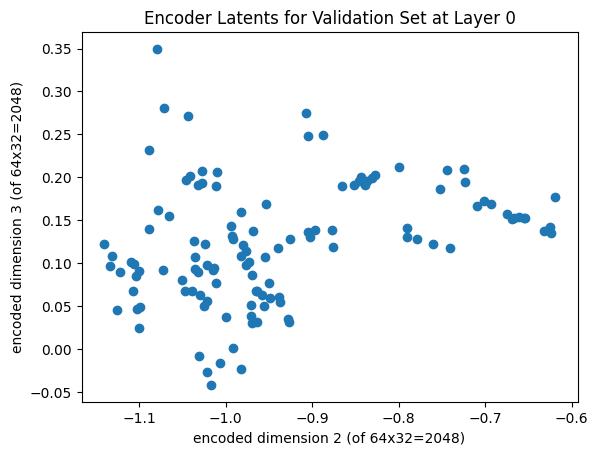

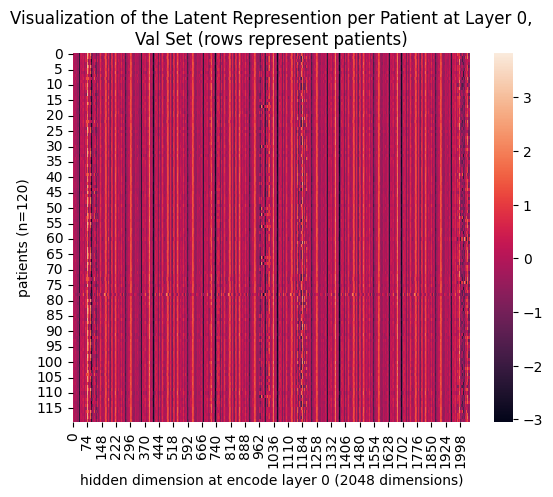

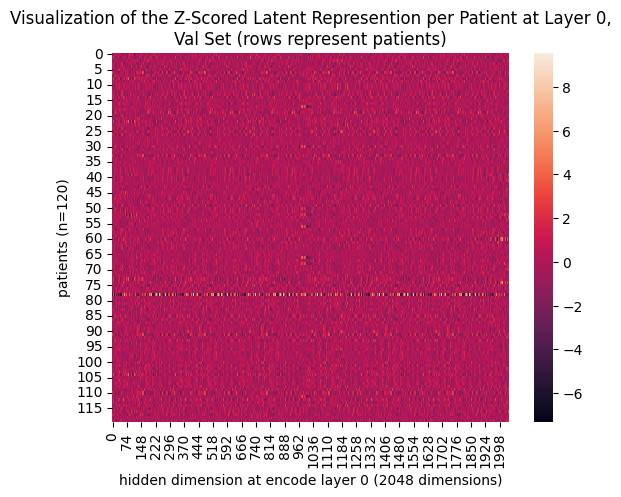

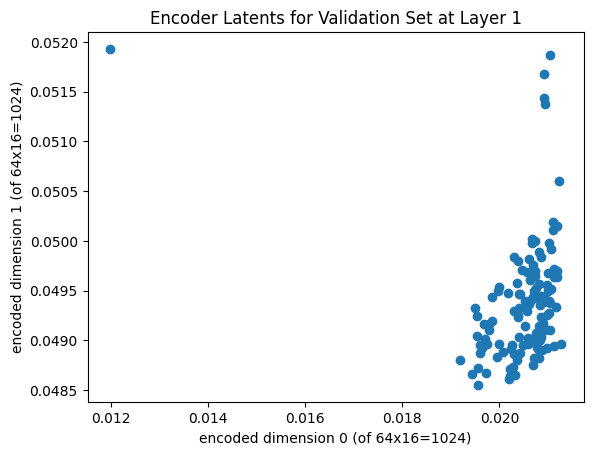

...

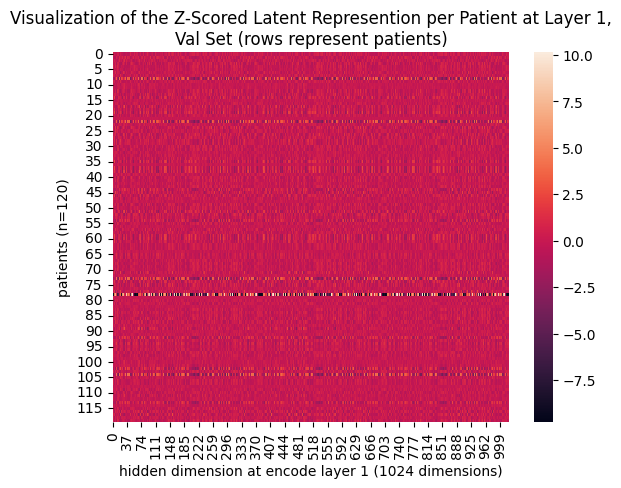

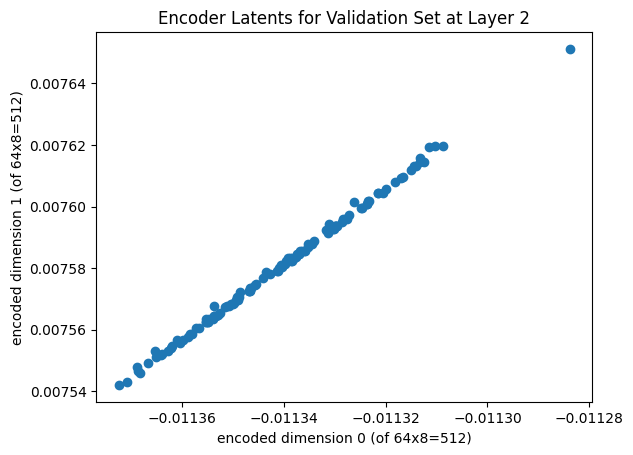

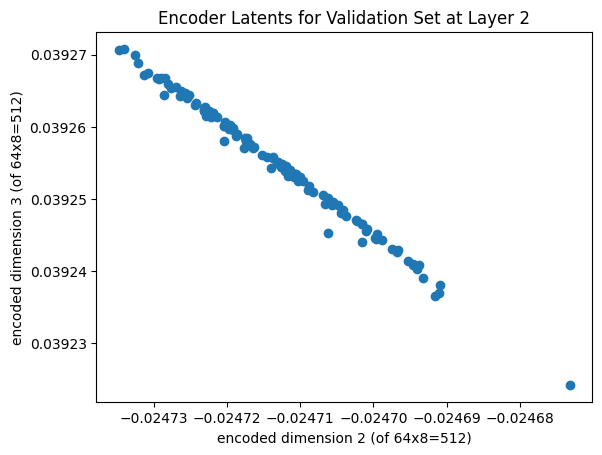

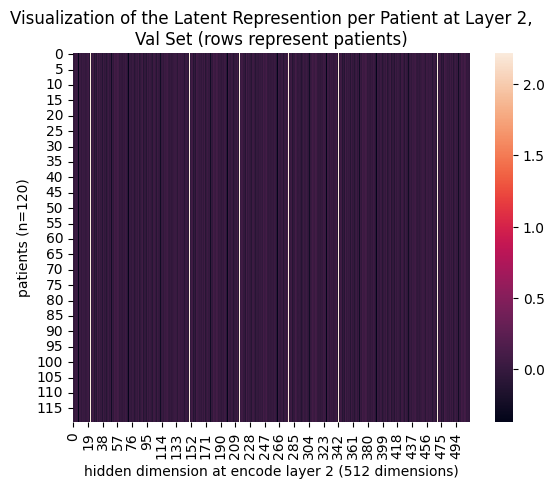

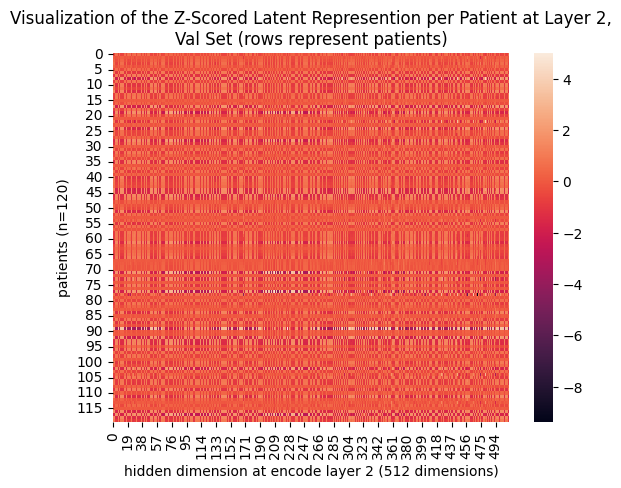

In [61]:
for layer in np.arange(len(summary['enc_hiddens'][0])):
    val_hiddens = torch.concat([batch[layer] for batch in summary['enc_hiddens']]) #final hidden rep in encoder for each patient in the val set
    val_hiddens = val_hiddens.reshape(val_hiddens.shape[0], -1)

    plt.scatter(val_hiddens[:,0],val_hiddens[:,1])
    plt.title("Encoder Latents for Validation Set at Layer {}".format(layer))
    plt.xlabel("encoded dimension 0 (of 64x{}={})".format(summary['enc_hiddens'][0][layer].shape[1], summary['enc_hiddens'][0][layer].shape[1]*64))
    plt.ylabel("encoded dimension 1 (of 64x{}={})".format(summary['enc_hiddens'][0][layer].shape[1], summary['enc_hiddens'][0][layer].shape[1]*64))
    plt.show()
    
    plt.scatter(val_hiddens[:,2],val_hiddens[:,3])
    plt.title("Encoder Latents for Validation Set at Layer {}".format(layer))
    plt.xlabel("encoded dimension 2 (of 64x{}={})".format(summary['enc_hiddens'][0][layer].shape[1], summary['enc_hiddens'][0][layer].shape[1]*64))
    plt.ylabel("encoded dimension 3 (of 64x{}={})".format(summary['enc_hiddens'][0][layer].shape[1], summary['enc_hiddens'][0][layer].shape[1]*64))
    plt.show()
    
    # visualize the dataset in heatmap
    sns.heatmap(val_hiddens)
    plt.title("Visualization of the Latent Represention per Patient at Layer {},\nVal Set (rows represent patients)".format(layer))
    plt.ylabel("patients (n={})".format(len(val_hiddens)))
    plt.xlabel("hidden dimension at encode layer {} ({} dimensions)".format(layer, val_hiddens.shape[1]))
    plt.show()
    
    # z score each latent dimension across patients
    scaled_hiddens = (val_hiddens - val_hiddens.mean(axis=0)) / val_hiddens.std(axis=0)
    sns.heatmap(scaled_hiddens)
    plt.title("Visualization of the Z-Scored Latent Represention per Patient at Layer {},\nVal Set (rows represent patients)".format(layer))
    plt.ylabel("patients (n={})".format(len(scaled_hiddens)))
    plt.xlabel("hidden dimension at encode layer {} ({} dimensions)".format(layer, val_hiddens.shape[1]))
    plt.show()

### train set

In [62]:
train_hiddens = torch.concat([batch[-1] for batch in summary_train['enc_hiddens']]) #final hidden rep in encoder for each patient in the val set
train_hiddens = train_hiddens.reshape(train_hiddens.shape[0], -1)

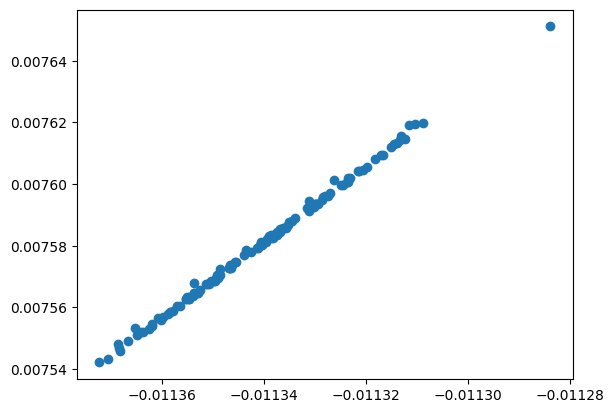

In [64]:
plt.scatter(val_hiddens[:,0],val_hiddens[:,1])
#plt.xlim(-1,1)
#plt.ylim(-1,1)

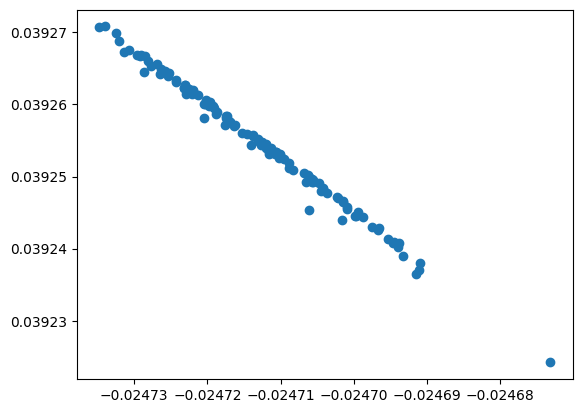

In [65]:
plt.scatter(val_hiddens[:,2],val_hiddens[:,3])
#plt.xlim(-1,1)
#plt.ylim(-1,1)

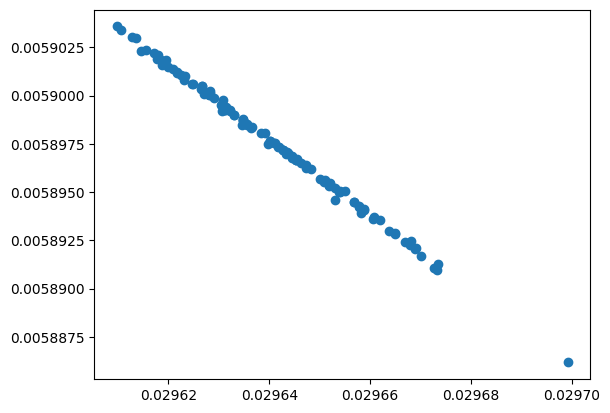

In [66]:
plt.scatter(val_hiddens[:,4],val_hiddens[:,5])
#plt.xlim(-1,1)
#plt.ylim(-1,1)

# PCA for 10 patients

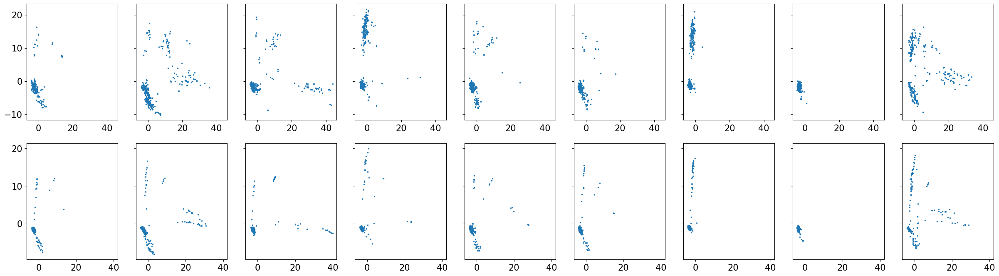

In [114]:
fig, axs = plt.subplots(2,9, figsize=(30,8), sharex="row", sharey="row",)# gridspec_kw={'hspace':0.3})
for idx, pid in enumerate(recon_adata.obs.pid.drop_duplicates()[:9]):
    axs[0, idx].scatter(gt_adata[gt_adata.obs.syn_pid == pid].obsm['X_pca'][:,0], gt_adata[gt_adata.obs.syn_pid == pid].obsm['X_pca'][:,1], s=2)
    axs[1, idx].scatter(recon_adata[recon_adata.obs.pid==pid].obsm['X_pca'][:,0], recon_adata[recon_adata.obs.pid==pid].obsm['X_pca'][:,1], s=2)
plt.show()

# Visualize outputs of the decoder

In [29]:
val_hiddens.shape

torch.Size([120, 512])

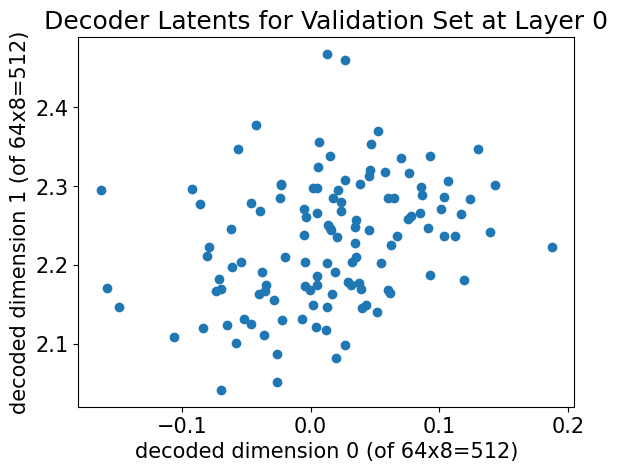

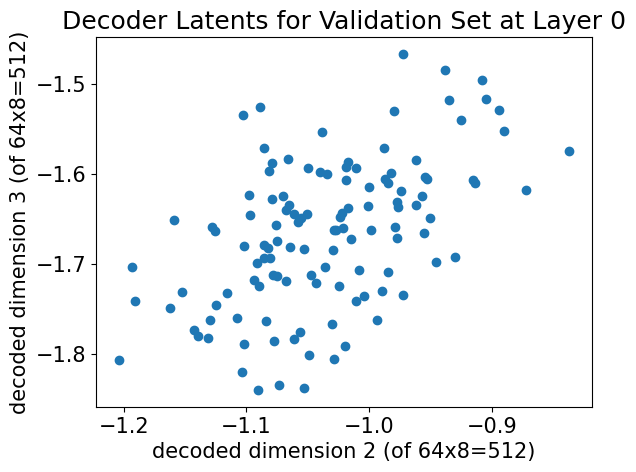

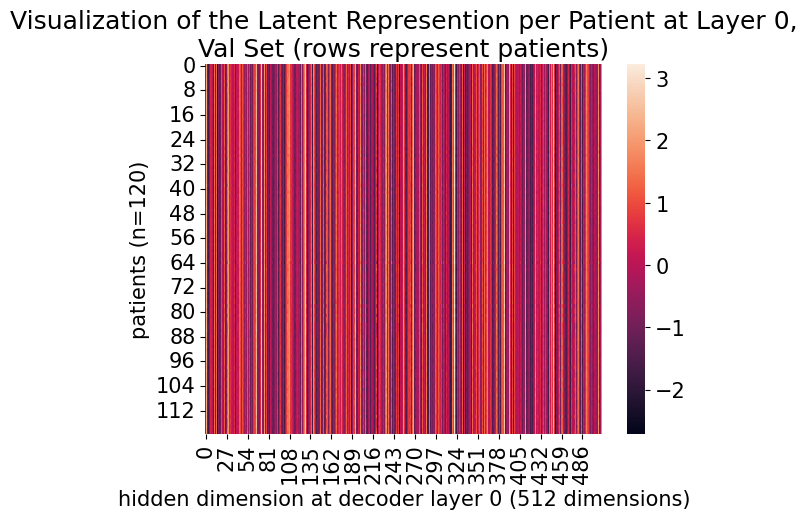

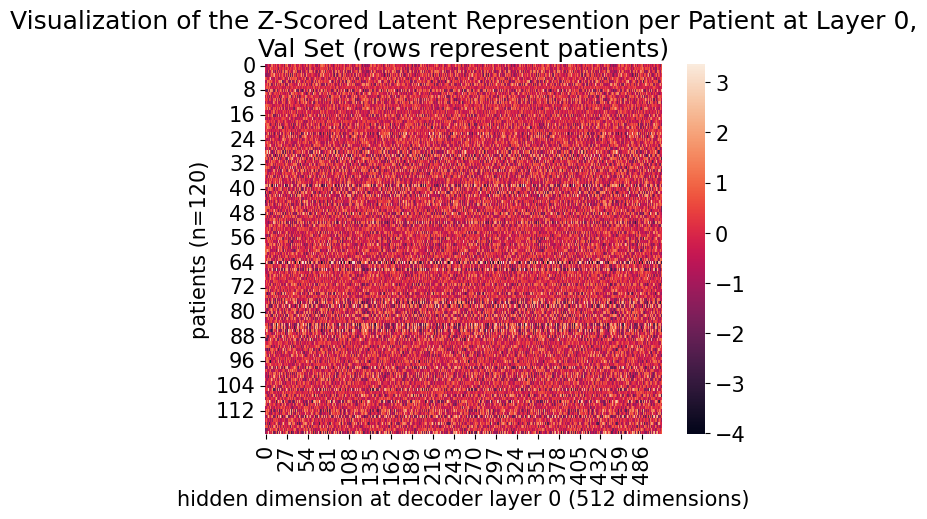

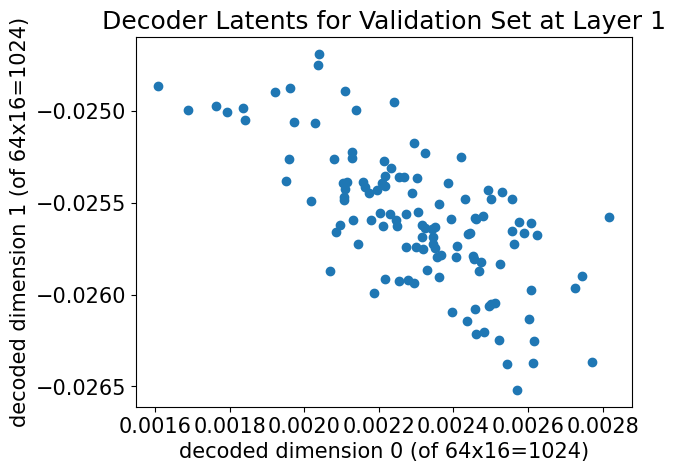

...

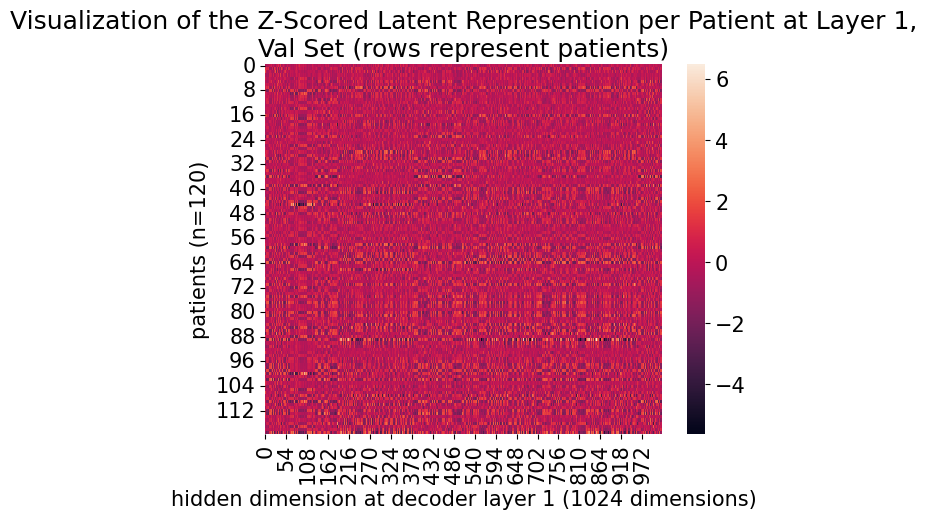

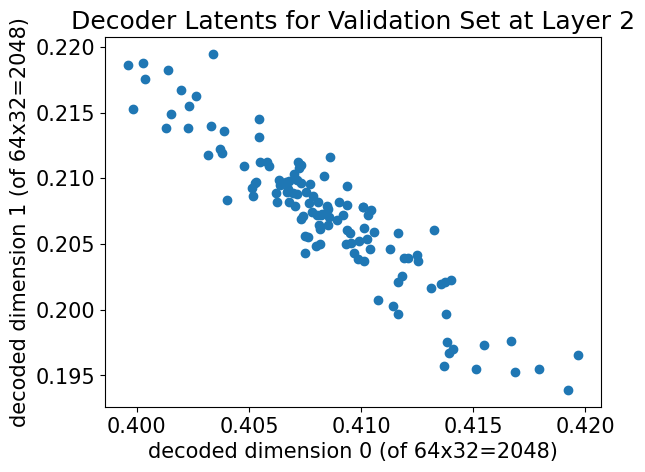

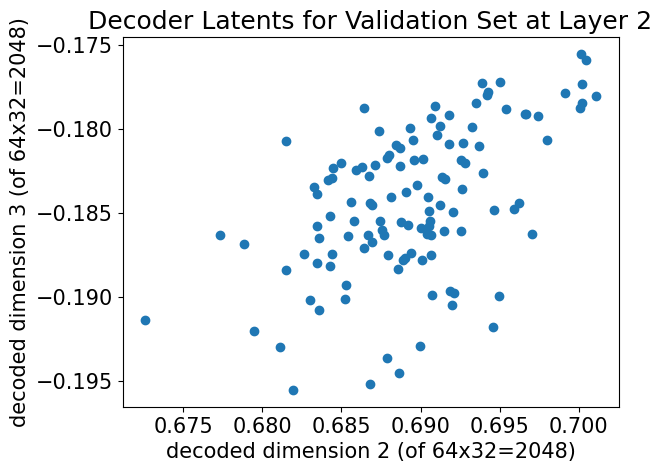

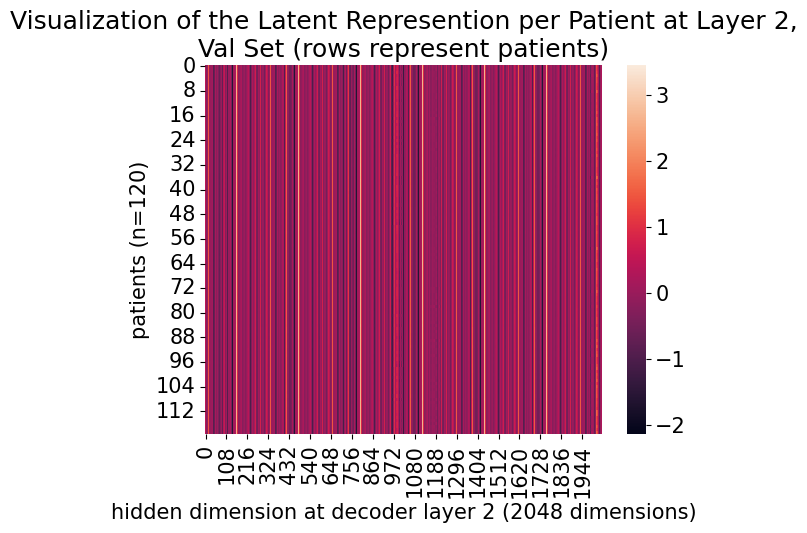

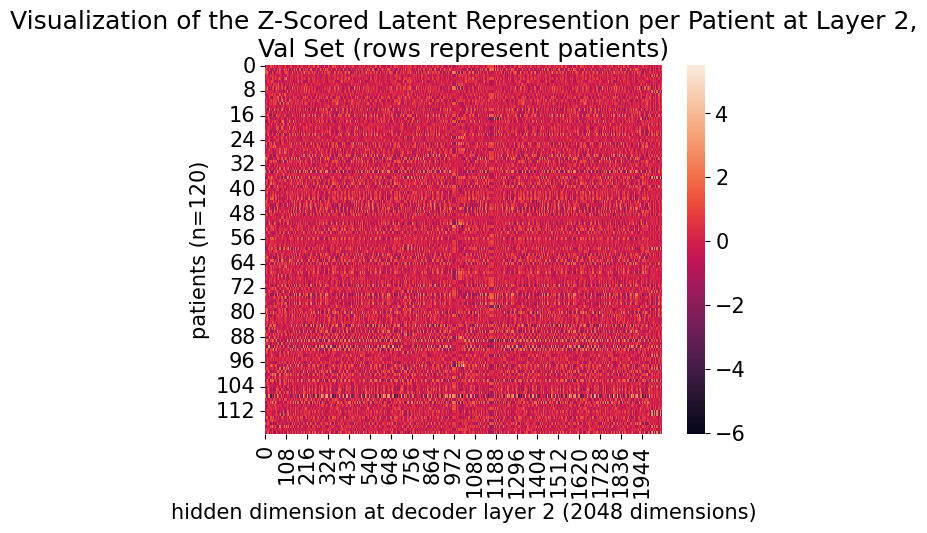

In [30]:
for layer in np.arange(len(summary['dec_hiddens'][0])):
    val_hiddens = torch.concat([batch[layer] for batch in summary['dec_hiddens']]) #final hidden rep in encoder for each patient in the val set
    val_hiddens = val_hiddens.reshape(val_hiddens.shape[0], -1)

    plt.scatter(val_hiddens[:,0],val_hiddens[:,1])
    plt.title("Decoder Latents for Validation Set at Layer {}".format(layer))
    plt.xlabel("decoded dimension 0 (of {}x{}={})".format(summary['dec_hiddens'][0][layer].shape[2], summary['dec_hiddens'][0][layer].shape[1], summary['dec_hiddens'][0][layer].shape[1]*summary['dec_hiddens'][0][layer].shape[2]))
    plt.ylabel("decoded dimension 1 (of {}x{}={})".format(summary['dec_hiddens'][0][layer].shape[2], summary['dec_hiddens'][0][layer].shape[1], summary['dec_hiddens'][0][layer].shape[1]*summary['dec_hiddens'][0][layer].shape[2]))
    plt.show()
    
    plt.scatter(val_hiddens[:,2],val_hiddens[:,3])
    plt.title("Decoder Latents for Validation Set at Layer {}".format(layer))
    plt.xlabel("decoded dimension 2 (of {}x{}={})".format(summary['dec_hiddens'][0][layer].shape[2], summary['dec_hiddens'][0][layer].shape[1], summary['dec_hiddens'][0][layer].shape[1]*summary['dec_hiddens'][0][layer].shape[2]))
    plt.ylabel("decoded dimension 3 (of {}x{}={})".format(summary['dec_hiddens'][0][layer].shape[2], summary['dec_hiddens'][0][layer].shape[1], summary['dec_hiddens'][0][layer].shape[1]*summary['dec_hiddens'][0][layer].shape[2]))
    plt.show()
    
    # visualize the dataset in heatmap
    sns.heatmap(val_hiddens)
    plt.title("Visualization of the Latent Represention per Patient at Layer {},\nVal Set (rows represent patients)".format(layer))
    plt.ylabel("patients (n={})".format(len(val_hiddens)))
    plt.xlabel("hidden dimension at decoder layer {} ({} dimensions)".format(layer, val_hiddens.shape[1]))
    plt.show()
    
    # z score each latent dimension across patients
    scaled_hiddens = (val_hiddens - val_hiddens.mean(axis=0)) / val_hiddens.std(axis=0)
    sns.heatmap(scaled_hiddens)
    plt.title("Visualization of the Z-Scored Latent Represention per Patient at Layer {},\nVal Set (rows represent patients)".format(layer))
    plt.ylabel("patients (n={})".format(len(scaled_hiddens)))
    plt.xlabel("hidden dimension at decoder layer {} ({} dimensions)".format(layer, val_hiddens.shape[1]))
    plt.show()

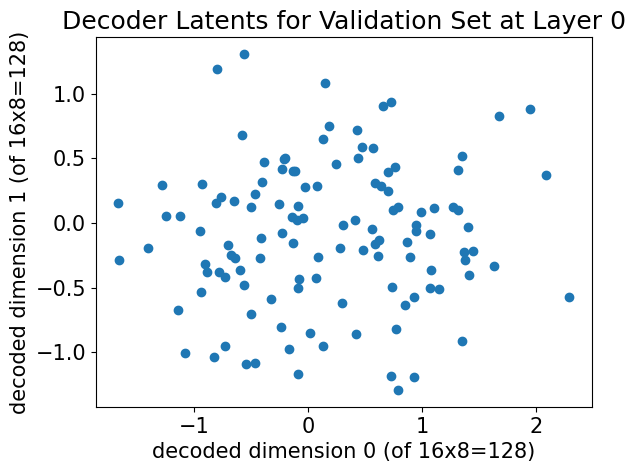

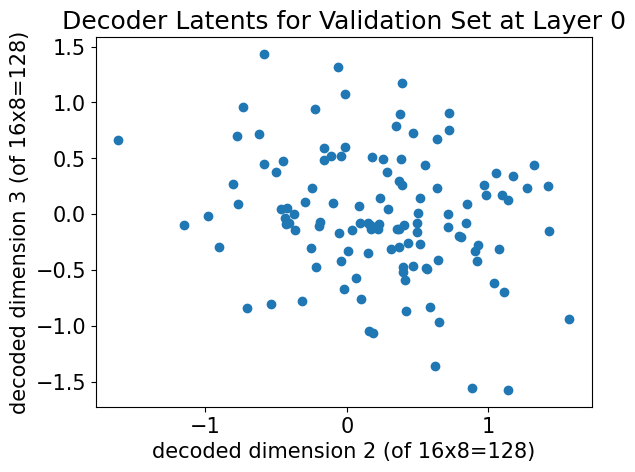

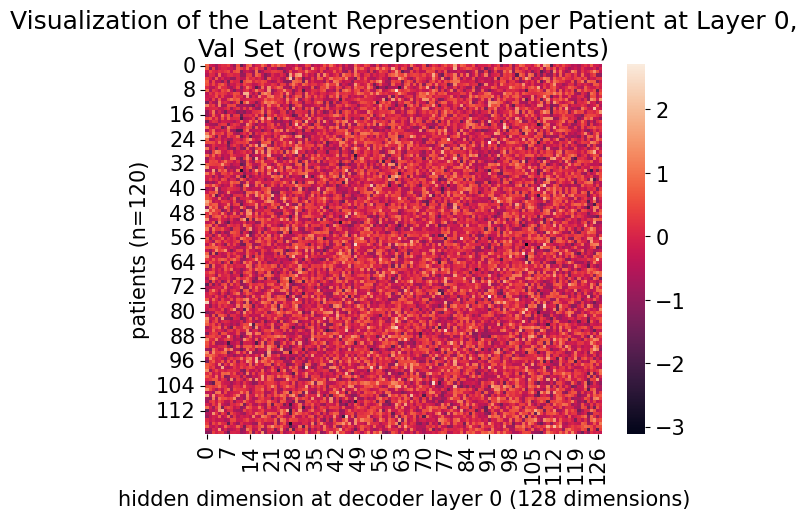

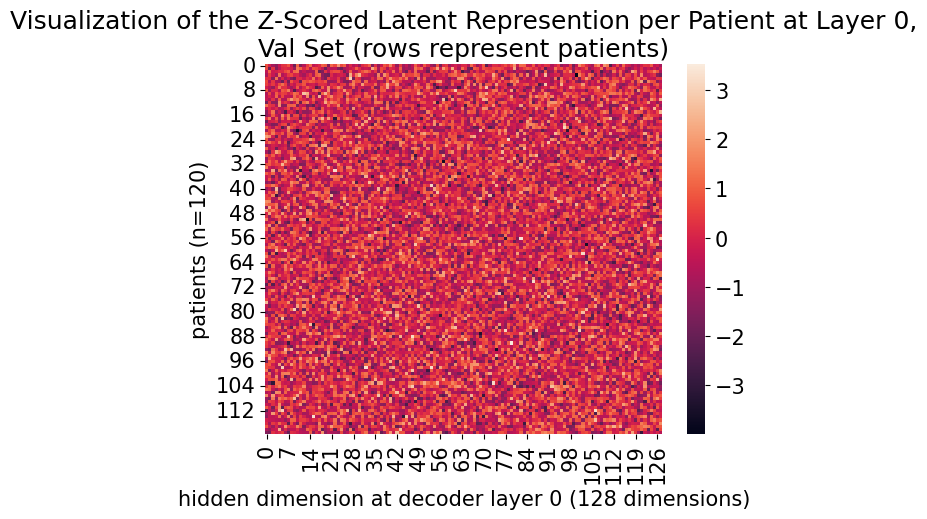

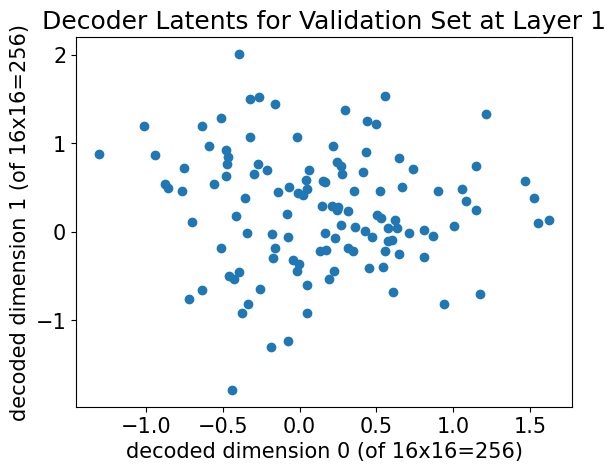

...

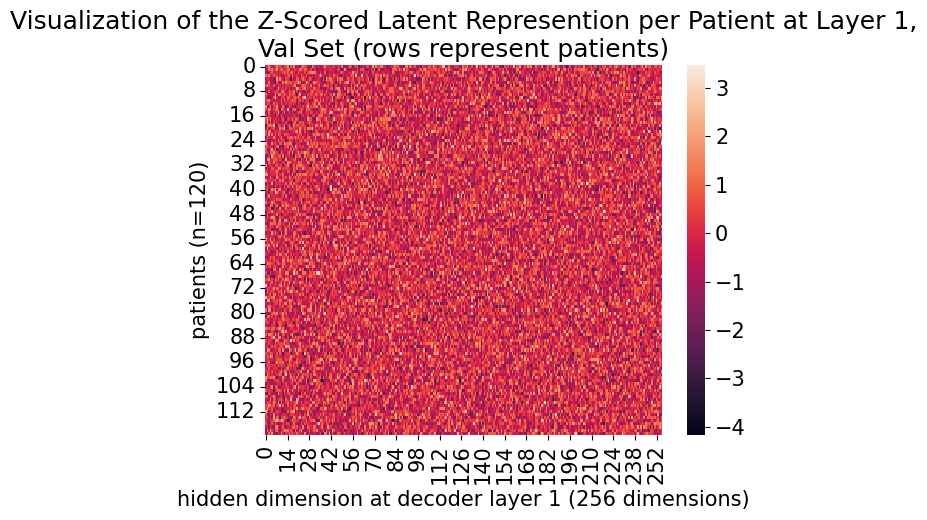

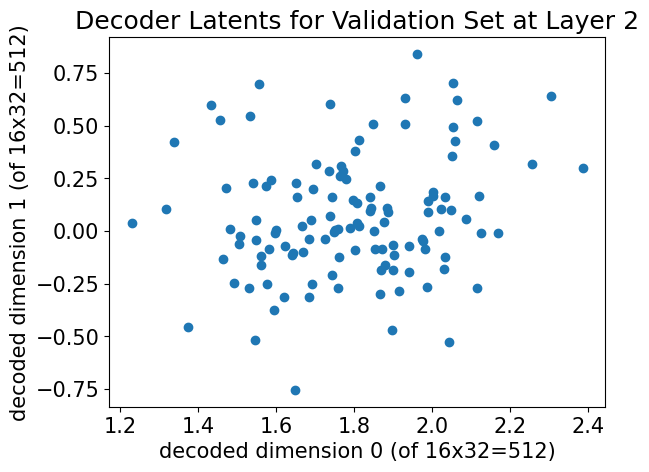

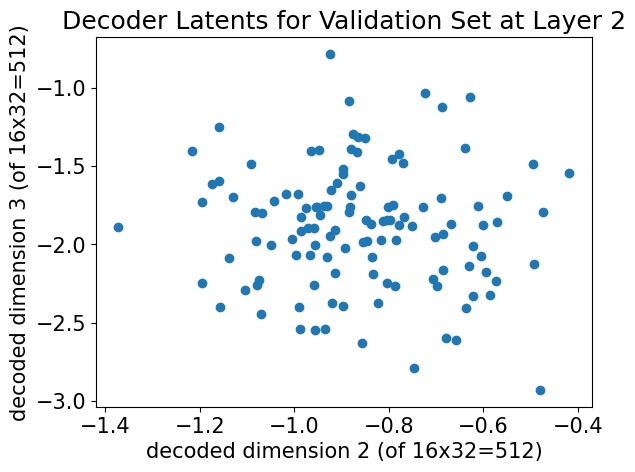

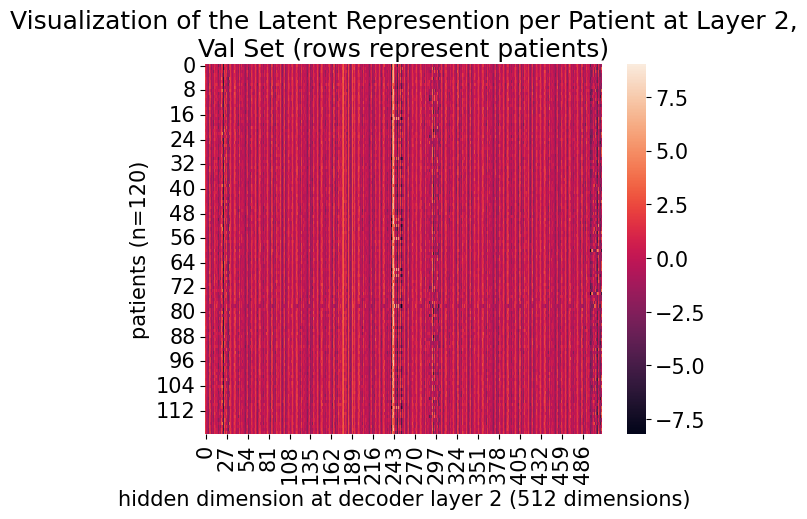

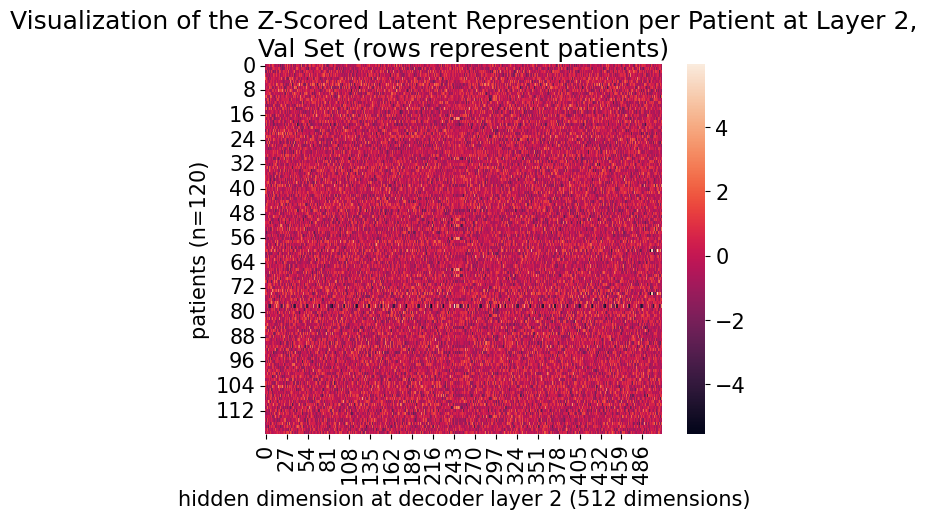

In [28]:
for layer in np.arange(len(summary['dec_latents'][0])):
    val_hiddens = torch.concat([batch[layer] for batch in summary['dec_latents']]) #final hidden rep in encoder for each patient in the val set
    val_hiddens = val_hiddens.reshape(val_hiddens.shape[0], -1)

    plt.scatter(val_hiddens[:,0],val_hiddens[:,1])
    plt.title("Decoder Latents for Validation Set at Layer {}".format(layer))
    plt.xlabel("decoded dimension 0 (of {}x{}={})".format(summary['dec_latents'][0][layer].shape[2], summary['dec_latents'][0][layer].shape[1], summary['dec_latents'][0][layer].shape[1]*summary['dec_latents'][0][layer].shape[2]))
    plt.ylabel("decoded dimension 1 (of {}x{}={})".format(summary['dec_latents'][0][layer].shape[2], summary['dec_latents'][0][layer].shape[1], summary['dec_latents'][0][layer].shape[1]*summary['dec_latents'][0][layer].shape[2]))
    plt.show()
    
    plt.scatter(val_hiddens[:,2],val_hiddens[:,3])
    plt.title("Decoder Latents for Validation Set at Layer {}".format(layer))
    plt.xlabel("decoded dimension 2 (of {}x{}={})".format(summary['dec_latents'][0][layer].shape[2], summary['dec_latents'][0][layer].shape[1], summary['dec_latents'][0][layer].shape[1]*summary['dec_latents'][0][layer].shape[2]))
    plt.ylabel("decoded dimension 3 (of {}x{}={})".format(summary['dec_latents'][0][layer].shape[2], summary['dec_latents'][0][layer].shape[1], summary['dec_latents'][0][layer].shape[1]*summary['dec_latents'][0][layer].shape[2]))
    plt.show()
    
    # visualize the dataset in heatmap
    sns.heatmap(val_hiddens)
    plt.title("Visualization of the Latent Represention per Patient at Layer {},\nVal Set (rows represent patients)".format(layer))
    plt.ylabel("patients (n={})".format(len(val_hiddens)))
    plt.xlabel("hidden dimension at decoder layer {} ({} dimensions)".format(layer, val_hiddens.shape[1]))
    plt.show()
    
    # z score each latent dimension across patients
    scaled_hiddens = (val_hiddens - val_hiddens.mean(axis=0)) / val_hiddens.std(axis=0)
    sns.heatmap(scaled_hiddens)
    plt.title("Visualization of the Z-Scored Latent Represention per Patient at Layer {},\nVal Set (rows represent patients)".format(layer))
    plt.ylabel("patients (n={})".format(len(scaled_hiddens)))
    plt.xlabel("hidden dimension at decoder layer {} ({} dimensions)".format(layer, val_hiddens.shape[1]))
    plt.show()

In [36]:
summary['init_set'][0,:,:]


tensor([[-0.5272,  0.3949,  0.7850,  ..., -1.4299, -0.6277,  0.5376],
        [-0.5408, -0.1936, -2.3875,  ...,  1.0226, -0.7304,  0.6337],
        [ 0.3260, -0.7090, -0.2415,  ...,  0.1284, -1.5373, -0.0463],
        ...,
        [ 1.1326,  0.8490, -0.8324,  ...,  0.5197, -0.7020, -1.7244],
        [ 0.8392,  0.1328,  0.6124,  ...,  0.6479, -1.0382, -1.6018],
        [-0.3661,  0.2882,  1.2501,  ..., -1.3043, -1.7624,  0.0565]])

In [45]:
summary['recon_mask'][0,:].sum()

tensor(349)